In [1]:
# system functions that are always useful to have
import time, sys, os

# basic numeric setup
import numpy as np

# inline plotting
%matplotlib inline

# plotting
import matplotlib
from matplotlib import pyplot as plt
import scienceplots

plt.style.use(['science', 'grid', 'high-vis'])

# seed the random number generator
rstate = np.random.default_rng(113)

In [2]:
# re-defining plotting defaults
from matplotlib import rcParams
rcParams.update({'xtick.major.pad': '7.0'})
rcParams.update({'xtick.major.size': '7.5'})
rcParams.update({'xtick.major.width': '1.5'})
rcParams.update({'xtick.minor.pad': '7.0'})
rcParams.update({'xtick.minor.size': '3.5'})
rcParams.update({'xtick.minor.width': '1.0'})
rcParams.update({'ytick.major.pad': '7.0'})
rcParams.update({'ytick.major.size': '7.5'})
rcParams.update({'ytick.major.width': '1.5'})
rcParams.update({'ytick.minor.pad': '7.0'})
rcParams.update({'ytick.minor.size': '3.5'})
rcParams.update({'ytick.minor.width': '1.0'})
rcParams.update({'font.size': 15})
rcParams.update({'figure.dpi': 300})

In [3]:
import dynesty
import GPy

### Red noise (real LC):

$$ y(t) = \sum \Delta t \cdot dist $$

where $ dist \sim N(0, \sigma)$

### Tick-tock signal:

$$ y(t) = A(t) \sin (2\pi ~f(t) ~t) $$

where $ A(t) = \exp(-gt) $, $g$ is the amplitude damping factor, and $f(t) = \frac{\exp(ht)}{T_{init}}$, $h$ being the frequency damping factor and $T_{init}$ the initial period.

Q: Can we use `dynesty` to get posteriors for $g$, $h$, and $T_{init}$ and maybe even $\sigma$ for the tick-tock signal?

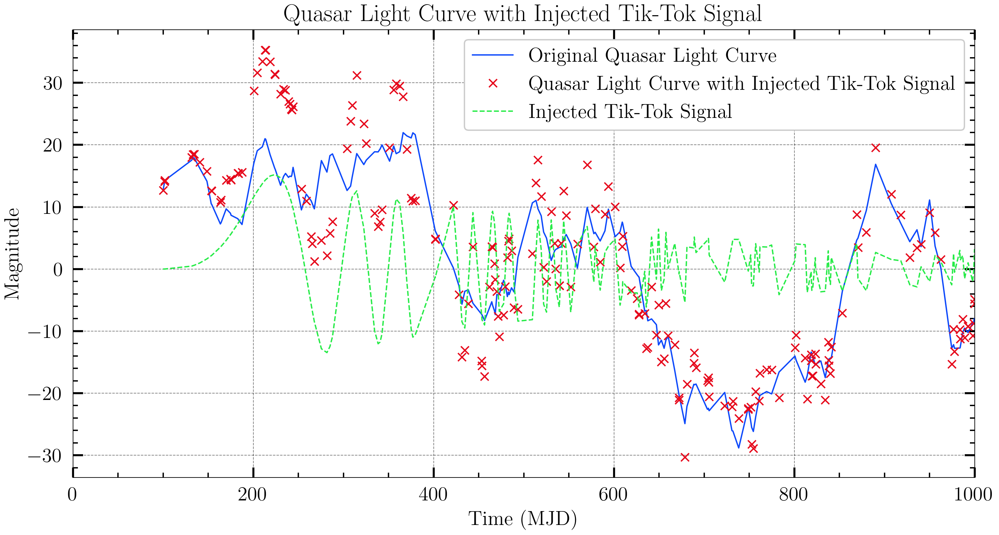

In [4]:
from scipy.interpolate import interp1d

np.random.seed(113)

def generate_red_noise(time_instances, sigma=0.1):
    delta_t = np.diff(time_instances, prepend=time_instances[0])
    disturbances = rstate.normal(scale=sigma, size=len(time_instances))
    red_noise = np.cumsum(delta_t * disturbances)
    # print(np.max(disturbances))
    return red_noise - red_noise.mean()

def generate_tiktok_signal(time_instances, initial_period, damping_factor_amplitude, damping_factor_frequency):
    frequency = (damping_factor_frequency * time_instances)**2 / (initial_period)
    amplitude = np.exp(-damping_factor_amplitude * time_instances)
    tiktok_signal = amplitude * np.sin(2 * np.pi * frequency * time_instances)
    return tiktok_signal

def inject_tiktok_to_light_curve(real_times, real_light_curve, initial_period, damping_factor_amplitude, damping_factor_frequency, snr=None, inject_signal=False):
    if not inject_signal:
        return real_light_curve, np.zeros_like(real_light_curve)

    t = np.linspace(real_times.min(), real_times.max(), 5 * len(real_times))
    tiktok_signal_regular = generate_tiktok_signal(t - t.min(), initial_period, damping_factor_amplitude, damping_factor_frequency)

    if snr is not None:
        noise_power = np.var(real_light_curve)
        signal_power = noise_power * snr
        scale_factor = np.sqrt(signal_power)
        tiktok_signal_regular *= scale_factor

    interpolator = interp1d(t, tiktok_signal_regular, kind='linear', fill_value="extrapolate")
    tiktok_signal_interpolated = interpolator(real_times)

    combined_light_curve = real_light_curve + tiktok_signal_interpolated
    return combined_light_curve, tiktok_signal_interpolated

real_times = np.sort(rstate.uniform(100, 1000, 200))
real_light_curve = generate_red_noise(real_times, sigma=0.5)  # Adjust sigma as needed

initial_period = 500
damping_factor_amplitude = 0.002
damping_factor_frequency = 0.008
snr = 2
inject_signal = True

combined_light_curve, tiktok_signal = inject_tiktok_to_light_curve(
    real_times,
    real_light_curve,
    initial_period,
    damping_factor_amplitude,
    damping_factor_frequency,
    snr,
    inject_signal
)

plt.figure(figsize=(12, 6))
plt.plot(real_times, real_light_curve, label='Original Quasar Light Curve')
if inject_signal:
    plt.plot(real_times, combined_light_curve, 'x', label='Quasar Light Curve with Injected Tik-Tok Signal')
    plt.plot(real_times, tiktok_signal, label='Injected Tik-Tok Signal', linestyle='--')
plt.xlim(0,1000)
plt.xlabel('Time (MJD)')
plt.ylabel('Magnitude')
plt.title('Quasar Light Curve with Injected Tik-Tok Signal')
plt.legend()
plt.show()

In [5]:
print(np.log10(0.002))
print(np.log10(0.008))
print(np.log10(0.25))

-2.6989700043360187
-2.0969100130080562
-0.6020599913279624


## Simple tick-tock signal

In [6]:
def try_generate_tiktok_signal(time_instances, params):
    T_init, g = params
    frequency = 1 / (T_init)
    amplitude = np.exp(-g * time_instances)
    tiktok_signal = amplitude * np.sin(2 * np.pi * frequency * time_instances)
    return tiktok_signal

In [7]:
real_times = np.sort(rstate.uniform(100,1000,200))
trial = try_generate_tiktok_signal(real_times, (500, 0.002))

0.12742452741484575


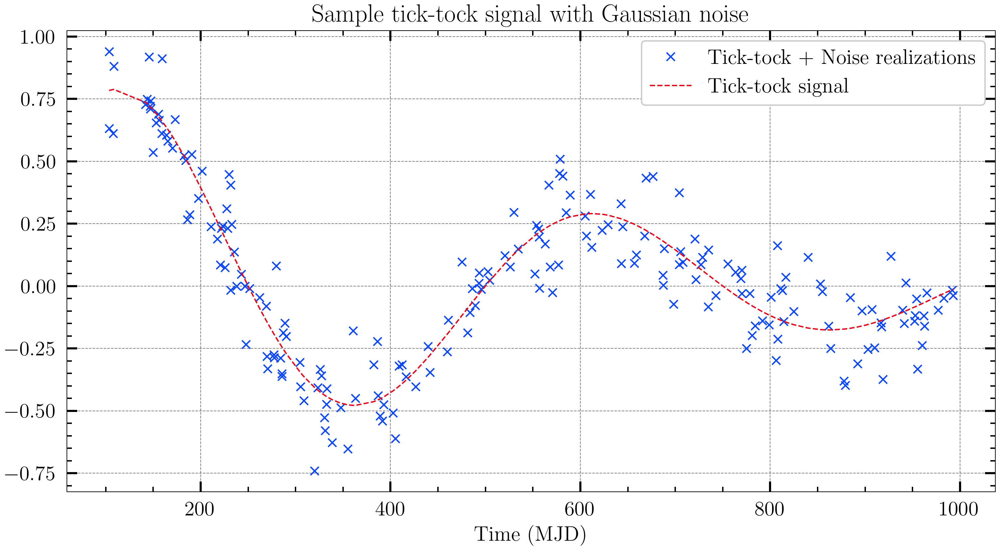

In [8]:
meansigma = np.mean(0.5*np.abs(trial))
print(meansigma)
y = rstate.normal(trial, meansigma)
plt.figure(figsize=(12,6))
plt.plot(real_times, y, 'x', label='Tick-tock + Noise realizations')
plt.plot(real_times, trial, label='Tick-tock signal')
plt.xlabel('Time (MJD)')
plt.title('Sample tick-tock signal with Gaussian noise')
plt.legend(loc='best')

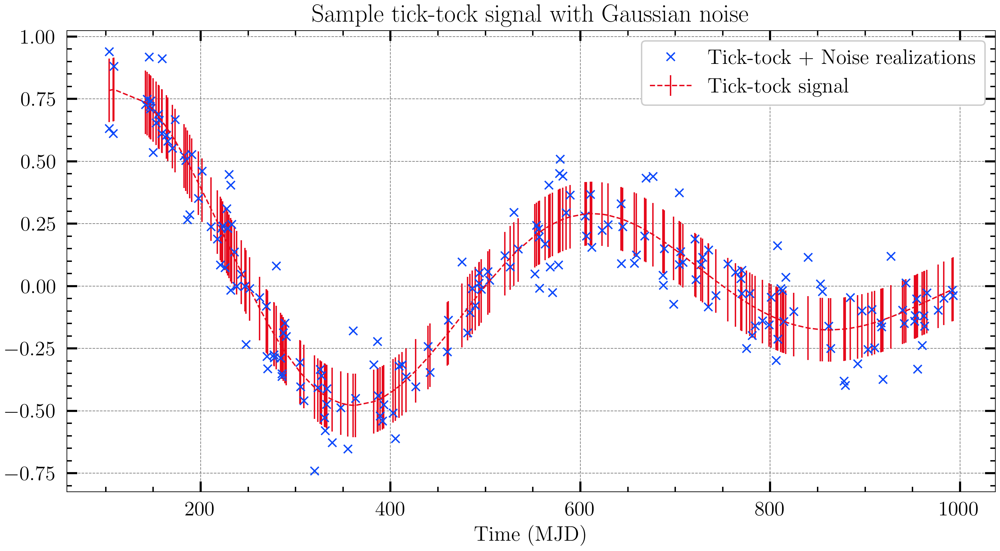

In [9]:
# meansigma = np.mean(0.5*np.abs(trial))
# print(meansigma)
# y = rstate.normal(trial, meansigma)
plt.figure(figsize=(12,6))
plt.plot(real_times, y, 'x', label='Tick-tock + Noise realizations')
plt.errorbar(real_times, trial, yerr=meansigma, label='Tick-tock signal')
plt.xlabel('Time (MJD)')
plt.title('Sample tick-tock signal with Gaussian noise')
plt.legend(loc='best')

In [10]:
# For tiktok signal with Gaussian noise

def prior_transform(u):
    """transforms from unit cube u~[0,1) to the variables 
    log g, T_init, log sigma (in order)"""
    v = u * 100
    v[0] = 5 * (u[0] * 2 - 1)
#     v[1] = 5 * (u[1] * 2 - 1)
    v[1] = 5 * (u[1] * 2 - 1)
    v[2] = 5 * (u[2] * 2 - 1)
    return v

def loglike(v):
    logg, logT_init, logsigma = v
    g, T_init, sigma = (10**logg, 10**logT_init, 10**logsigma)
    # Create instances of the tiktok signal with different parameters
#     real_times = np.sort(np.random.uniform(100, 1000, 200))
    ypred = try_generate_tiktok_signal(real_times, (T_init, g))
    residsq = (ypred - y)**2 / sigma**2
    loglike = -0.5 * np.sum(residsq + np.log(2 * np.pi * sigma**2))
    
    if not np.isfinite(loglike):
        loglike = -1e300
        
    return loglike

In [11]:
# sample
sampler = dynesty.DynamicNestedSampler(loglike, prior_transform, ndim=3,
                                bound='multi', sample='rslice', nlive=2000,
                               rstate=rstate)
sampler.run_nested()
res = sampler.results

51623it [01:31, 565.78it/s, batch: 1 | bound: 5 | nc: 1 | ncall: 1445833 | eff(%):  3.427 | loglstar: 130.291 < 132.900 < 132.044 | logz: 115.345 +/-  0.093 | stop:  0.628]           


In [12]:
# sampler for posterior estimation
sampler.reset()
sampler.run_nested(nlive_init=2000, nlive_batch=500, wt_kwargs={'pfrac': 1.0}, stop_kwargs={'pfrac': 1.0})
respos = sampler.results

48090it [01:22, 583.30it/s, batch: 1 | bound: 5 | nc: 1 | ncall: 1386048 | eff(%):  3.432 | loglstar: 130.406 < 132.890 < 132.056 | logz: 115.138 +/-  0.093 | stop:  0.886]           


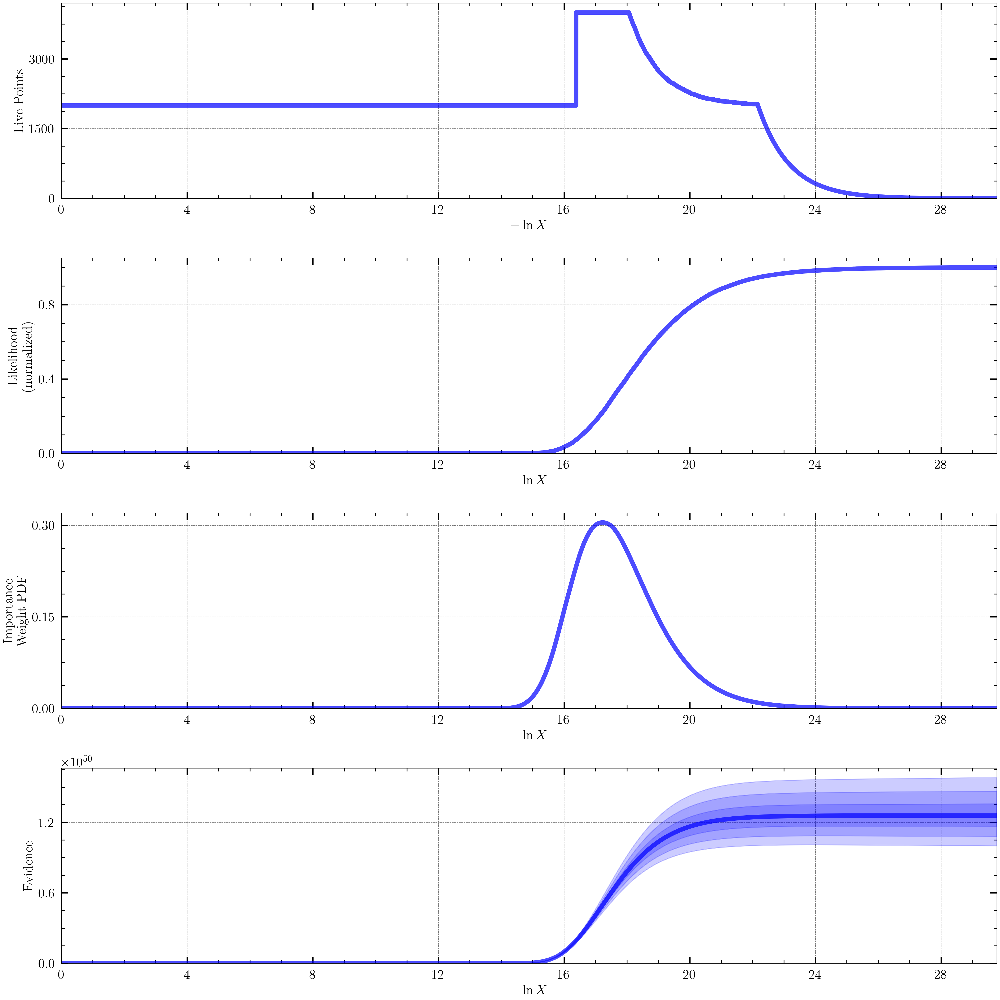

In [13]:
from dynesty import plotting as dyplot

dyplot.runplot(res)
plt.tight_layout()

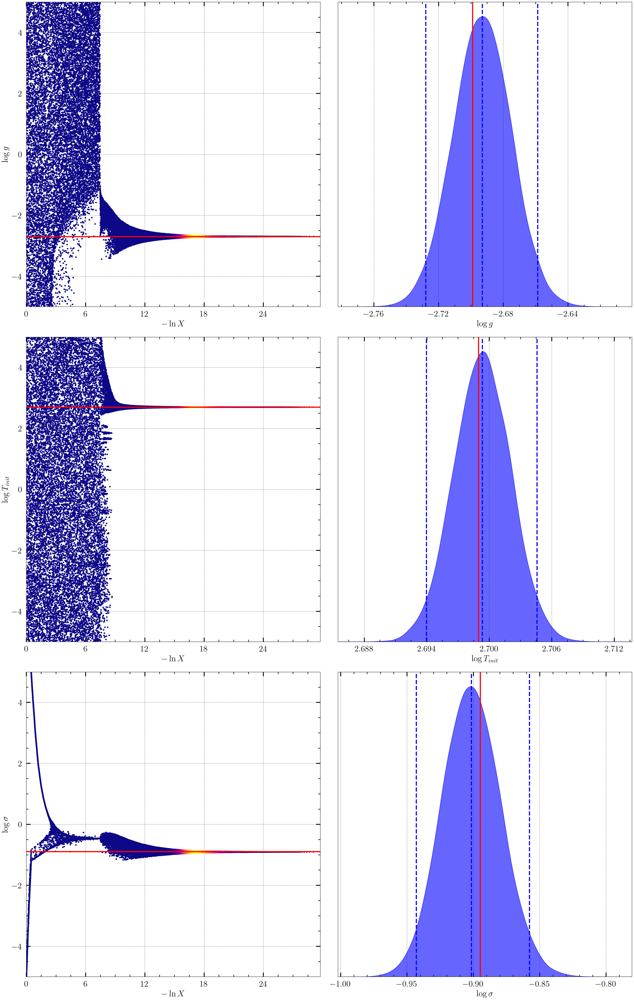

In [14]:
labels = [r'$\log g$', r'$\log T_{init}$', r'$\log \sigma$']
truths = [np.log10(0.002), np.log10(500), np.log10(meansigma)]
fig, axes = dyplot.traceplot(res, labels=labels, truths=truths,
                             fig=plt.subplots(3, 2, figsize=(16, 25)))
fig.tight_layout()

In [15]:
fig, axes = dyplot.cornerplot(respos, truths=truths, show_titles=True, 
                              title_kwargs={'y': 1.04}, labels=labels,
                              fig=plt.subplots(3,3, figsize=(35, 35)))

In [16]:
best_fit_params = respos.samples[np.argmax(respos.logl)]
print(10**best_fit_params)

error = np.array([[best_fit_params[0] - 0.03, best_fit_params[1] - 0.01, best_fit_params[2] - 0.04],
                  [best_fit_params[0] + 0.03, best_fit_params[1] + 0.01, best_fit_params[2] + 0.04]])
print(10**error)

# print(10**error[1][0])

[2.02525954e-03 5.00432130e+02 1.24562811e-01]
[[1.89008217e-03 4.89040904e+02 1.13602634e-01]
 [2.17010469e-03 5.12088691e+02 1.36580406e-01]]


In [17]:
bestfitmodel = try_generate_tiktok_signal(real_times, (10**best_fit_params[1], 10**best_fit_params[0]))
model_16th = try_generate_tiktok_signal(real_times, (10**error[0][1], 10**error[0][0]))
model_84th = try_generate_tiktok_signal(real_times, (10**error[1][1], 10**error[1][0]))
# data_16th = rstate.normal(model_16th, 10**error[0][2])
# data_84th = rstate.normal(model_84th, 10**error[1][2])

# print(data_16th)

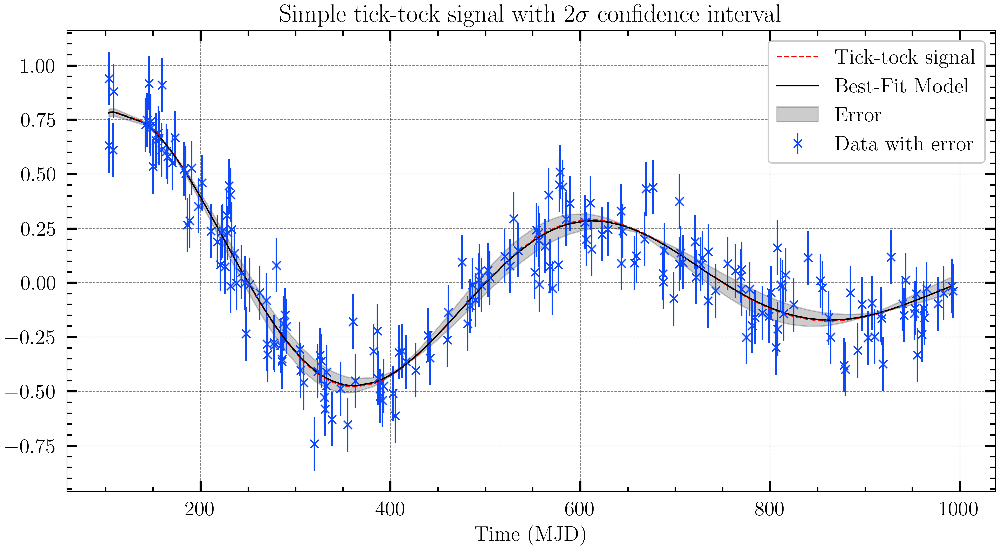

In [18]:
plt.figure(figsize=(12,6))
plt.errorbar(real_times, y, yerr=10**best_fit_params[2], fmt='x', label='Data with error')
plt.plot(real_times, trial, 'r--', label='Tick-tock signal')
plt.plot(real_times, bestfitmodel, 'k-', label='Best-Fit Model')
plt.fill_between(real_times, model_16th, model_84th,
                 color='black', alpha=0.2, label='Error')
plt.xlabel('Time (MJD)')
plt.title(r'Simple tick-tock signal with $2\sigma$ confidence interval')
plt.legend(loc='best')

## More complicated tick-tock signal

$$ y(t) = A(t) \sin (2\pi ~f(t) ~t) $$

where $ A(t) = \exp(-gt) $, $g$ is the amplitude damping factor, and $f(t) = \frac{(ht)^2}{T_{init}}$, $h$ being the frequency damping factor and $T_{init}$ the initial period. The squared factor in $f(t)$ is "supposed" to mimic the exponential increase in frequency.


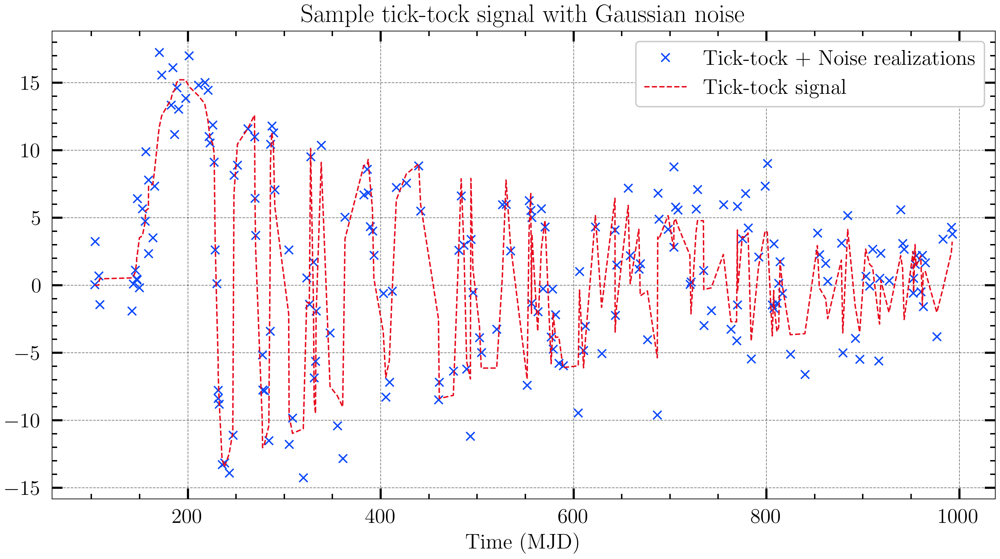

In [19]:
meansigma = np.mean(0.5*np.abs(tiktok_signal))
y = rstate.normal(tiktok_signal, meansigma)
plt.figure(figsize=(12,6))
plt.plot(real_times, y, 'x', label='Tick-tock + Noise realizations')
plt.plot(real_times, tiktok_signal, label='Tick-tock signal')
plt.xlabel('Time (MJD)')
plt.title('Sample tick-tock signal with Gaussian noise')
plt.legend(loc='best')

In [20]:
def prior_transform(u):
    """transforms from unit cube u~[0,1) to the variables 
    log g, log h, T_init, log sigma (in order)"""
    v = u * 100
    v[0] = 5 * (u[0] * 2 - 1) # log g = [10^-5, 10^5]
    v[1] = 5 * (u[1] * 2 - 1) # log h = [10^-5, 10^5]
    v[2] = 5 * (u[2] * 2 - 1)
    v[3] = 5 * (u[3] * 2 - 1)
    return v

def loglike(v):
    logg, logh, logT_init, logsigma = v
    g, h, T_init, sigma = (10**logg, 10**logh, 10**logT_init, 10**logsigma)
    ypred = generate_tiktok_signal(real_times, T_init, g, h)
    residsq = (ypred - y)**2 / sigma**2
    loglike = -0.5 * np.sum(residsq + np.log(2 * np.pi * sigma**2))
    
    if not np.isfinite(loglike):
        loglike = -1e300
        
    return loglike

In [21]:
# sample
sampler = dynesty.DynamicNestedSampler(loglike, prior_transform, ndim=4,
                                bound='multi', sample='rslice', nlive=2000,
                               rstate=rstate)
sampler.run_nested()
res = sampler.results

14073it [00:23, 225.43it/s, batch: 0 | bound: 12 | nc: 36 | ncall: 392348 | eff(%):  3.569 | loglstar:   -inf < -668.061 <    inf | logz: -673.504 +/-  0.049 | dlogz:  2.850 >  0.010]    /home/mibrivera/anaconda3/lib/python3.9/site-packages/dynesty/sampling.py:420: UserWarning:The slice sample interval was expanded more than 1000 times
 /home/mibrivera/anaconda3/lib/python3.9/site-packages/dynesty/sampling.py:684: UserWarning:Enabling doubling strategy of slice sampling from Neal(2003)
36653it [02:28, 247.24it/s, batch: 1 | bound: 5 | nc: 1 | ncall: 2342889 | eff(%):  1.493 | loglstar: -669.262 < -663.706 < -668.203 | logz: -673.109 +/-  0.053 | stop:  0.647]         


In [22]:
# sampler for posterior estimation
sampler.reset()
sampler.run_nested(nlive_init=500, nlive_batch=500, wt_kwargs={'pfrac': 1.0}, stop_kwargs={'pfrac': 1.0})
respos = sampler.results

15000it [00:43, 343.73it/s, batch: 8 | bound: 9 | nc: 1 | ncall: 886103 | eff(%):  1.642 | loglstar: -671.372 < -663.700 < -668.109 | logz: -673.208 +/-  0.074 | stop:  0.911]        


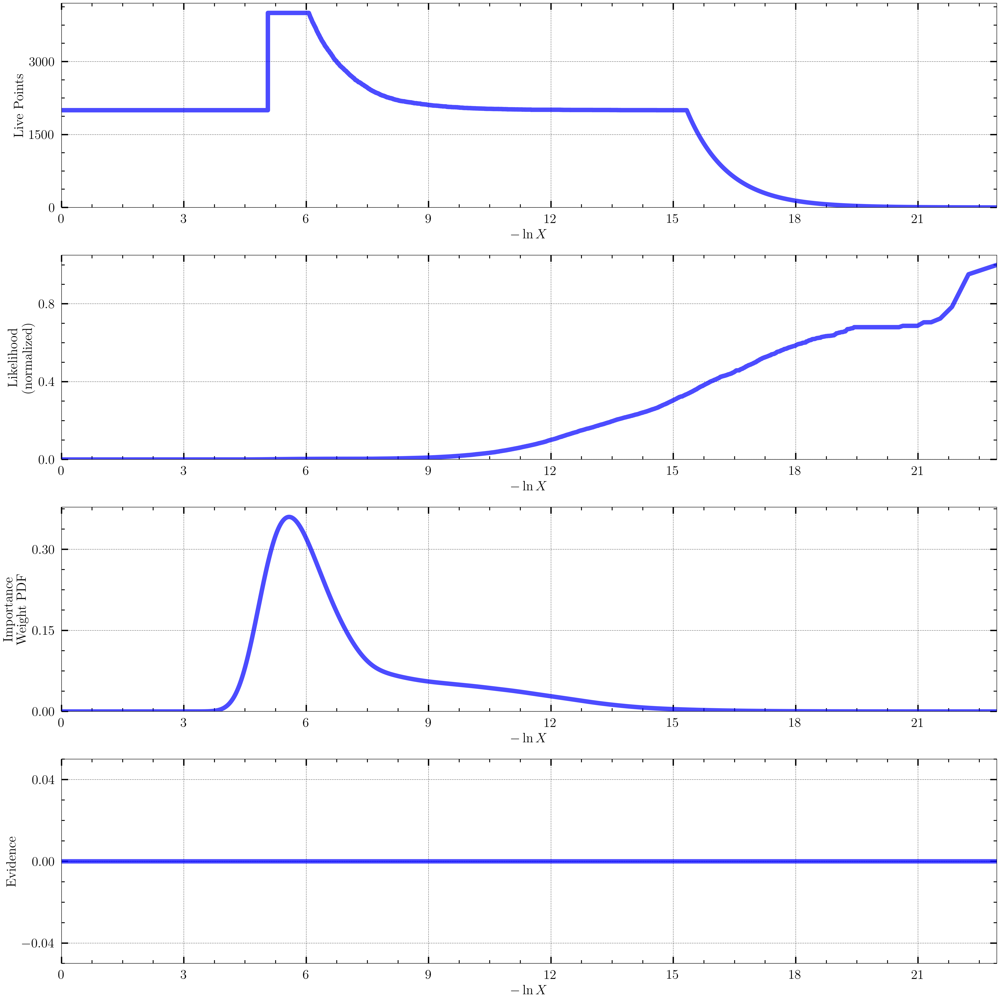

In [23]:
from dynesty import plotting as dyplot

dyplot.runplot(res)
plt.tight_layout()

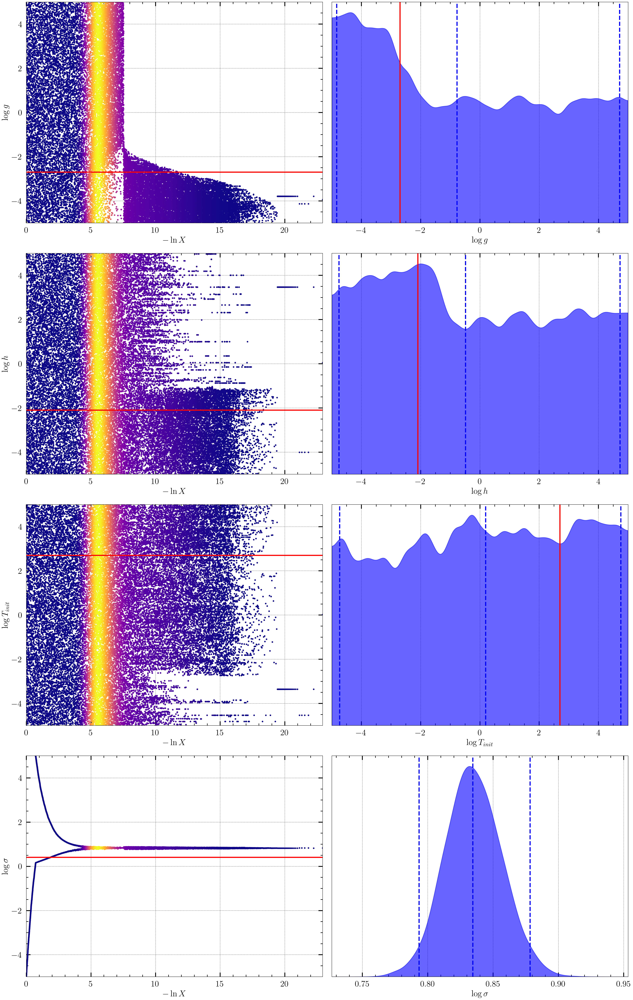

In [24]:
labels = [r'$\log g$', r'$\log h$', r'$\log T_{init}$', r'$\log \sigma$']
truths = [np.log10(0.002), np.log10(0.008), np.log10(500), np.log10(meansigma)]
fig, axes = dyplot.traceplot(res, labels=labels, truths=truths,
                             fig=plt.subplots(4, 2, figsize=(16, 25)))
fig.tight_layout()

In [25]:
fig, axes = dyplot.cornerplot(respos, truths=truths, show_titles=True, 
                              title_kwargs={'y': 1.04}, labels=labels,
                              fig=plt.subplots(4,4, figsize=(35, 35)))

In [26]:
best_fit_params = respos.samples[np.argmax(respos.logl)]
print(best_fit_params)

# error = np.array([[best_fit_params[0] - 0.03, best_fit_params[1] - 0.01, best_fit_params[2] - 0.04],
#                   [best_fit_params[0] + 0.03, best_fit_params[1] + 0.01, best_fit_params[2] + 0.04]])
# print(10**error)

[-4.54689939  1.08579225  0.56205455  0.81018653]
